In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

In [2]:
dataset_path = "C:/Users/jonghui/Downloads/DressCode/cloth/upper_body/"

img_list = []
for img in os.listdir(dataset_path):
    if img.endswith("1.jpg"):
        img_list.append(img)

print(img_list)

['000000_1.jpg', '000001_1.jpg', '000002_1.jpg', '000003_1.jpg', '000004_1.jpg', '000005_1.jpg', '000006_1.jpg', '000007_1.jpg', '000008_1.jpg', '000009_1.jpg', '000010_1.jpg', '000011_1.jpg', '000012_1.jpg', '000013_1.jpg', '000014_1.jpg', '000015_1.jpg', '000016_1.jpg', '000017_1.jpg', '000018_1.jpg', '000019_1.jpg', '000020_1.jpg', '000021_1.jpg', '000022_1.jpg', '000023_1.jpg', '000024_1.jpg', '000025_1.jpg', '000026_1.jpg', '000027_1.jpg', '000028_1.jpg', '000029_1.jpg', '000030_1.jpg', '000031_1.jpg', '000032_1.jpg', '000033_1.jpg', '000034_1.jpg', '000035_1.jpg', '000036_1.jpg', '000037_1.jpg', '000038_1.jpg', '000039_1.jpg', '000040_1.jpg', '000041_1.jpg', '000042_1.jpg', '000043_1.jpg', '000044_1.jpg', '000045_1.jpg', '000046_1.jpg', '000047_1.jpg', '000048_1.jpg', '000049_1.jpg', '000050_1.jpg', '000051_1.jpg', '000052_1.jpg', '000053_1.jpg', '000054_1.jpg', '000055_1.jpg', '000056_1.jpg', '000057_1.jpg', '000058_1.jpg', '000059_1.jpg', '000060_1.jpg', '000061_1.jpg', '000062

In [3]:
print(len(img_list))

15363


In [4]:
# for i in range(3):
#     for j in range(3):
#         img = plt.imread(dataset_path + img_list[i*3+j])
#         plt.subplot(3, 3, i*3+j+1)
#         plt.axis('off')
#         plt.imshow(img)

In [5]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

class CustomImageDataset(Dataset):
    def __init__(self, directory, transform=None):
        self.directory = directory
        self.transform = transform
        self.images = [f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.directory, self.images[idx])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

dataset = CustomImageDataset(directory=dataset_path, transform=transform)

# Create a DataLoader
dataloader = DataLoader(dataset, batch_size=32, shuffle=False)

In [6]:
import torch
from torchvision.models import resnet50

# Initialize the pre-trained model
model = resnet50(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Adapt the model to use it as a feature extractor
model = torch.nn.Sequential(*(list(model.children())[:-1]))

if torch.cuda.is_available():
    device = torch.device("cuda")
    print('device: cuda')
else:
    device = torch.device("cpu")
    print('device: cpu')
model = model.to(device)

# Feature extraction function
def extract_features(dataloader, model, device):
    features = []
    with torch.no_grad():
        for inputs in dataloader:
            inputs = inputs.to(device)  # Move input data to the GPU
            outputs = model(inputs).flatten(start_dim=1)
            features.append(outputs.cpu().numpy())  # Move the tensors back to CPU for numpy conversion
    return np.concatenate(features, axis=0)

# Extract features
features = extract_features(dataloader, model, device)

c:\Users\jonghui\anaconda3\envs\torch_book\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\jonghui\anaconda3\envs\torch_book\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


device: cuda


In [7]:
features.shape

(15363, 2048)

In [13]:
features.mean()

0.3773038

In [ ]:
### word2vec

In [17]:
import json

# JSON 파일을 열고 내용을 읽어옵니다.
with open('../labeling/dresscode.json', 'r') as file:
    data = json.load(file)

# 읽어온 데이터를 출력합니다.
print(data)

{'020714': ['multicolor one-shoulder a-line dress', 'multicolor one-shoulder asymmetric dress', 'multicolor one-shoulder lace dress'], '020715': ["black women's jersey tank dress", 'black sleeveless scoop neck maxi dress', 'black hi-low tank dress'], '020716': ['gray scoop neck maxi tank dress', 'purple overlay tank dress', 'overlay maxi dress'], '020717': ["white women's cutout sheath dress", "green maison women's open back long dress", 'white cold-shoulder jersey dress'], '020718': ['night dress', 'black sleeveless nightgown', 'black full slip'], '020719': ['multicolor maison cape', 'multicolor asymmetric apron shirt dress', 'multicolor wrap front split'], '020720': ['short-sleeve printed maxi dress', 'floral-print tiered dress', 'short-sleeve dress'], '020721': ['black floral-embroidered dress', 'black long-sleeve embroidered gown', 'black floral-embroidered gown'], '020722': ['pink gown cut-out', 'pink cut-out midi dress', 'pink cutout dress'], '020723': ['black faux leather wrap d

In [18]:
num_upper_body = 15363
num_lower_body = 8951
num_dresses = 29478
num_upper_body + num_lower_body + num_dresses # 53792

53792

In [19]:
## dresscode_dict 생성

dresscode_dict = {}
for key in data:
    items = [word for item in data[key] for word in item.split(' ')]
    dresscode_dict[key] = list(set(items))
len(dresscode_dict)

53792

In [20]:
dresscode_dict['020715']

["women's",
 'neck',
 'dress',
 'jersey',
 'black',
 'tank',
 'hi-low',
 'maxi',
 'scoop',
 'sleeveless']

In [21]:
# 상, 하의, dress로 구분한 dict
import os

dataset_path = 'C:/Users/jonghui/Downloads/DressCode/cloth/'

upper_list = []
lower_list = []
dress_list = []

for filename in os.listdir(dataset_path + 'upper_body'):
    # print(filename[:6])
    upper_list.append(filename[:6])
for filename in os.listdir(dataset_path + 'lower_body'):
    lower_list.append(filename[:6])
for filename in os.listdir(dataset_path + 'dresses'):
    dress_list.append(filename[:6])
        # if 'upper' in file:
            
        # elif 'lower' in file:
        #     lower_list.append(file)
        # elif 'dress' in file:
        #     dress_list.append(file)
    
# for key in data:
#     items = [word for item in data[key] for word in item.split(' ')]
#     if key in upper_dict:
#         upper_dict[key] = list(set(items))
    

In [22]:
upper_list[:10]

['000000',
 '000001',
 '000002',
 '000003',
 '000004',
 '000005',
 '000006',
 '000007',
 '000008',
 '000009']

In [23]:
upper_dict = {}
lower_dict = {}
dress_dict = {}

for key in data:
    items = [word for item in data[key] for word in item.split(' ')]
    if key in upper_list:
        upper_dict[key] = list(set(items))
    elif key in lower_list:
        lower_dict[key] = list(set(items))
    elif key in dress_list:
        dress_dict[key] = list(set(items))

In [24]:
len(upper_dict)

15363

In [25]:
upper_dict_sen = {} # json에서 상의에 대한 sentence만 추출한 dict

for key, value in data.items():
    if key in upper_list: # 상의에 대한 sentence만 추출
        upper_dict_sen[key] = value

upper_dict_sen['000001']

['blue western long-sleeve denim shirt',
 'slim fit denim shirt',
 'blue embroidered denim shirt']

In [26]:
# upper_dict_sen을 reverse해 저장 -> value로 key를 찾을 수 있도록
# 가장 유사한 문장을 찾아, 해당 문장의 key를 반환하도록 할 것임
upper_dict_sen_rev = {}
for key, values in upper_dict_sen.items():
    for v in values:
        upper_dict_sen_rev[v] = key 
upper_dict_sen_rev

{'multicolor military style shirt': '049499',
 'multicolor military shirt': '049499',
 'multicolor green army shirt jacket': '048526',
 'blue western long-sleeve denim shirt': '048974',
 'slim fit denim shirt': '049882',
 'blue embroidered denim shirt': '000024',
 "red women's valery top": '050044',
 'raw edge denim crop top exclusive': '013419',
 'sporty dark colored top': '009856',
 'blue long sleeved bardot top': '006455',
 'shoulder top navy': '049721',
 'front long sleeve bardot': '048533',
 'denim shirt blue': '050025',
 'pocket denim shirt': '000004',
 'blue colorblock chambray shirt': '048982',
 'blue mixed-media button-front shirt': '001968',
 'blue mixed-media shirt': '049041',
 'denim blouse': '050026',
 'denim top': '011589',
 'blue denim martine top': '050026',
 'blue domino denim shirt': '049377',
 'denim blouse blue': '049135',
 'indigo shirt blue': '048982',
 'chambray shirt': '048993',
 'blue slim denim shirt': '049882',
 'white prep school denim shirt': '008424',
 'wh

In [27]:
# 상의에 대한 문장들을 list로 저장
upper_sentences = [s.split() for sentences in upper_dict_sen.values() for s in sentences] # 상의에 대한 sentence list
upper_sentences[:10]

[['multicolor', 'military', 'style', 'shirt'],
 ['multicolor', 'military', 'shirt'],
 ['multicolor', 'green', 'army', 'shirt', 'jacket'],
 ['blue', 'western', 'long-sleeve', 'denim', 'shirt'],
 ['slim', 'fit', 'denim', 'shirt'],
 ['blue', 'embroidered', 'denim', 'shirt'],
 ['red', "women's", 'valery', 'top'],
 ['raw', 'edge', 'denim', 'crop', 'top', 'exclusive'],
 ['sporty', 'dark', 'colored', 'top'],
 ['blue', 'long', 'sleeved', 'bardot', 'top']]

In [28]:
from gensim.models import Word2Vec
# sentences = [["hello", "world"], ["hello", "from", "python"]]
model = Word2Vec(upper_sentences, vector_size=1000, window=5, min_count=5, workers=4)
vector = model.wv['multicolor']  # 'hello' 단어의 벡터를 가져옴
vector.shape

(1000,)

In [38]:
from gensim.models import Word2Vec
from numpy import average, dot
from numpy.linalg import norm

# 문장을 벡터로 변환하는 함수
def sentence_to_vector(sentence, model):
    vectors = [model.wv[word] for word in sentence if word in model.wv]
    if vectors:
        return average(vectors, axis=0)
    else:
        return np.zeros(model.vector_size)

def sentences_to_vector(sentences, model):
    return [sentence_to_vector(sentence, model) for sentence in sentences]


sentences = []
vec = []
for sen in upper_sentences:
    vec.append(sentence_to_vector(sen, model))
print(len(vec)) # 46089
vec_3to1 = []
i = 0
for i in range(len(vec)//3):
    try:
        vec_3to1.append((vec[i*3]+vec[i*3+1]+vec[i*3+2])/3)
    except:
        print(i)
        print(i*3, i*3+1, i*3+2)
        print(vec[i*3], vec[i*3+1], vec[i*3+2])
        print(upper_sentences[i*3], upper_sentences[i*3+1], upper_sentences[i*3+2])
        break

vec_3to1

46089


[array([ 3.28189433e-02,  1.04584647e-02,  6.06628470e-02,  1.47386670e-01,
        -1.31456479e-01, -1.03139924e-02, -3.74102104e-03,  8.23420659e-02,
        -5.12275249e-02, -3.29150967e-02,  1.22307479e-01,  2.30706558e-02,
        -3.48695368e-03,  6.36155978e-02,  1.01675473e-01, -3.27177197e-02,
        -3.33620869e-02, -9.03761201e-03,  4.83222073e-03, -1.42053947e-01,
         1.32833287e-01,  3.70091349e-02, -5.35114594e-02,  1.33609965e-01,
         1.41143426e-01, -2.65351105e-02, -6.10871911e-02, -4.05207239e-02,
        -1.44142255e-01,  1.02702035e-02,  3.47184986e-02,  3.09037566e-02,
         7.54873604e-02, -8.11872110e-02, -5.05971611e-02, -2.75879377e-03,
         3.29883695e-02,  3.51058207e-02,  7.78240934e-02, -7.14998916e-02,
        -1.39944926e-01,  4.05806601e-02, -1.36142001e-01,  7.41126463e-02,
        -7.16933534e-02, -3.99908759e-02, -1.13171101e-01,  1.57855019e-01,
        -3.30897607e-02,  1.13539398e-02, -2.58504506e-03,  2.26775203e-02,
        -3.9

In [33]:
46089/3

15363.0

In [41]:
vec_3to1 = np.array(vec_3to1)

In [42]:
vec_3to1.shape

(15363, 1000)

In [ ]:
### image features + word2vec

In [43]:
f = np.concatenate([features, vec_3to1], axis=1)
f.shape

(15363, 3048)

In [44]:
#save model
np.save('./features_word_mix.npy', f)

In [46]:
from sklearn.cluster import KMeans

# Clustering
kmeans = KMeans(n_clusters=100, random_state=22)
clusters = kmeans.fit_predict(f)

In [47]:
print(len(clusters))
print(clusters)
print(len(set(clusters)))

15363
[26 10 18 ... 49 15 55]
100


In [48]:
cluster_groups = {0: [], 1: [], 2: [], 3: [], 4: [], 5: [], 6: [], 7: [], 8: [], 9: []}
for i, cluster in enumerate(clusters):
    # print(i, cluster)
    if cluster not in cluster_groups:
        cluster_groups[cluster] = []
    
    cluster_groups[cluster].append(img_list[i])

In [49]:
print(cluster_groups.keys())

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 26, 10, 18, 31, 81, 43, 92, 19, 64, 34, 42, 37, 22, 25, 73, 86, 65, 61, 44, 21, 47, 36, 14, 95, 83, 40, 84, 27, 28, 56, 87, 68, 71, 97, 91, 74, 15, 55, 29, 38, 66, 33, 82, 88, 89, 63, 46, 67, 77, 75, 17, 52, 70, 69, 45, 12, 78, 16, 99, 32, 54, 96, 80, 72, 13, 79, 58, 53, 76, 20, 60, 62, 94, 35, 30, 39, 51, 98, 50, 41, 11, 57, 93, 23, 49, 85, 90, 59, 24, 48])


In [52]:
def print_cluster_img(num):
    for i in range(15):
        img = plt.imread(dataset_path + 'upper_body/' + cluster_groups[num][i])
        plt.subplot(3, 5, i+1)
        plt.axis('off')
        plt.imshow(img)

C:\Users\jonghui\AppData\Local\Temp\ipykernel_22192\1804572213.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


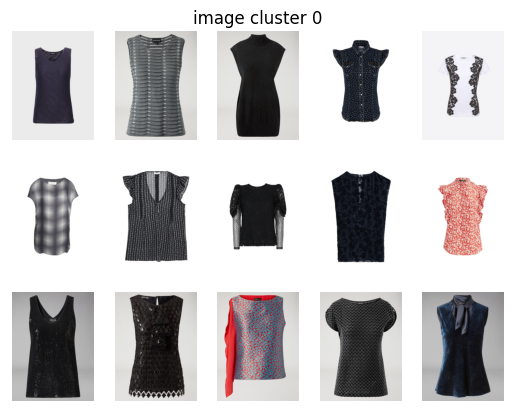

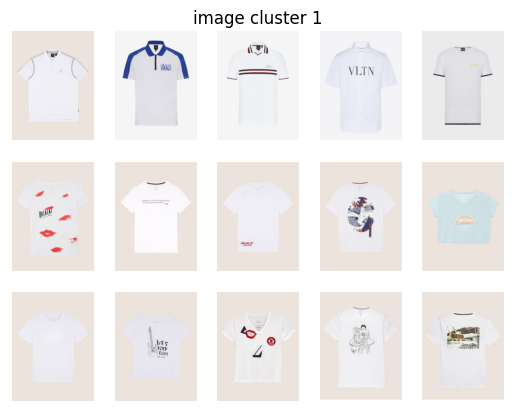

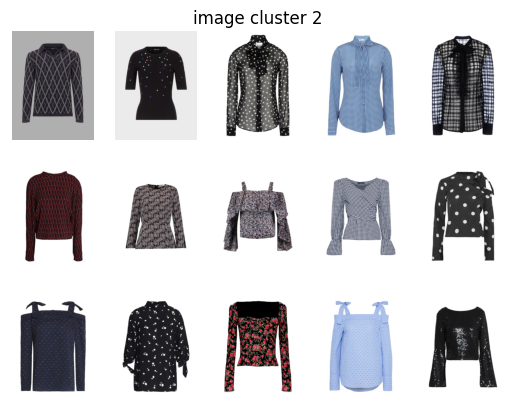

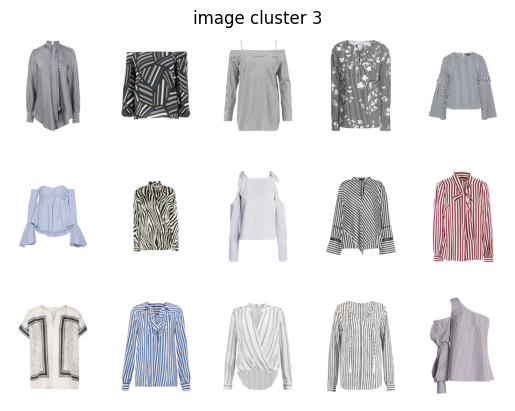

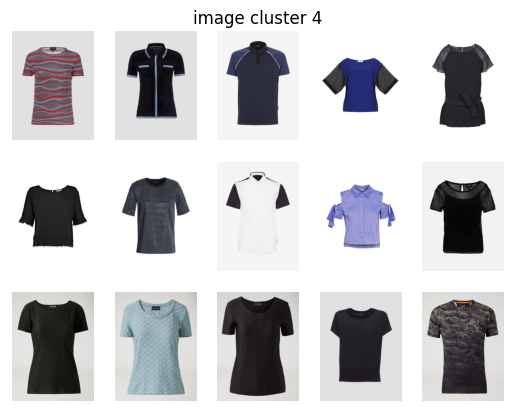

...

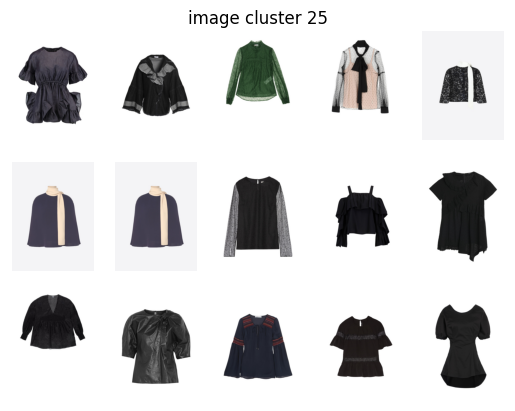

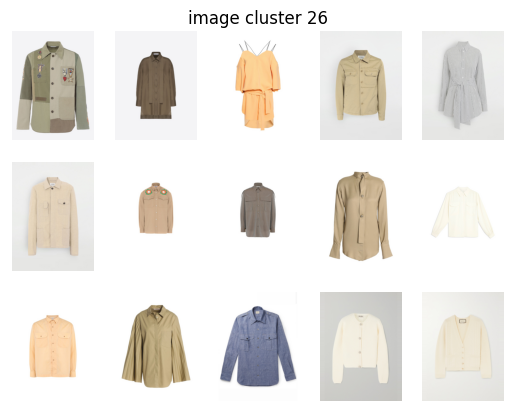

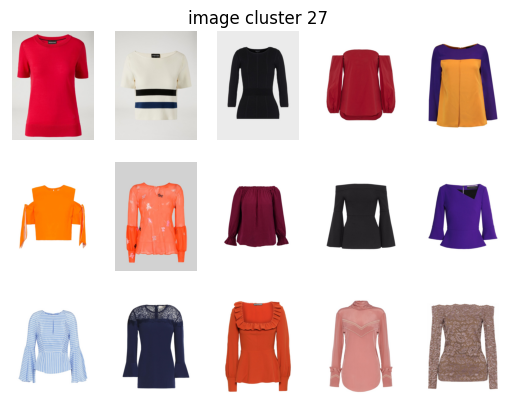

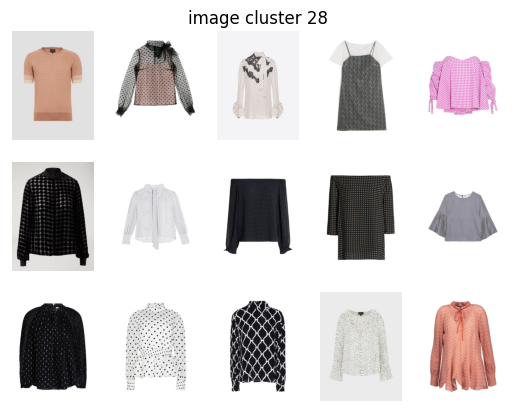

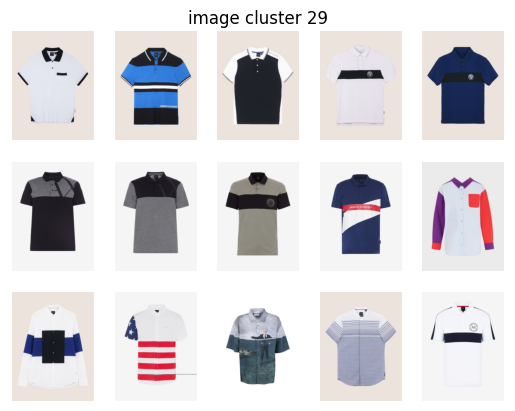

In [53]:
for i in range(30):
    plt.figure()
    plt.axis('off')
    plt.title(f'image cluster {i}')
    print_cluster_img(i)